In [1]:
import pandas as pd
import os
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

from math import sqrt

def smape(A, F):
    return 100/len(A) * np.sum(2 * np.abs(F - A) / (np.abs(A) + np.abs(F)))

def vape(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred))/np.mean(np.abs(y_true))
import gc

gc.enable()

# Importing LGBM and XGBOOST
import lightgbm as lgb
from lightgbm import early_stopping
from lightgbm import log_evaluation

import plotly.express as px
from IPython.display import display, HTML

import shap

shap.initjs()

In [2]:
cwd = os.getcwd()
data_store_path_dir = os.path.join(cwd, "../data_tmp/")

In [3]:
#df = pd.read_csv("../data_tmp/train.csv",).drop(["Unnamed: 0"], axis=1)
df_original = pd.read_parquet(os.path.join(data_store_path_dir, "train.parquet"))

In [4]:
df_original.head(3)

,campaign_name,campaign_status,date,keyword,keyword_match_type,ad_group,cpc,clicks,client_profile_id,campaign_name_0_category,...,ad_group_3_category,ad_group_4_category,keyword_match_type_0_category,date_obj,month_dt,day_in_month_dt,day_of_week_dt,day_in_year_dt,week_in_year_dt,is_holiday
0,calgary cochrane maintenance ac services prior...,ENABLED,2021-07-03,air conditioner services,phrase,air conditioning servicing,0.000,0,1,314,...,329,329,139,2021-07-03,7,3,5,184,26,False
1,edmonton maintenance furnace services priority 4,ENABLED,2021-07-01,furnace cleaning edmonton,exact,furnace cleaning,19.055,2,1,268,...,329,329,323,2021-07-01,7,1,3,182,26,True
2,calgary branding,PAUSED,2020-05-13,action furnace,broad,action furnace,0.000,0,1,314,...,329,329,245,2020-05-13,5,13,2,134,20,False


In [5]:
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1256766 entries, 0 to 1256765
Data columns (total 39 columns):
 #   Column                         Non-Null Count    Dtype         
---  ------                         --------------    -----         
 0   campaign_name                  1256766 non-null  object        
 1   campaign_status                1256766 non-null  object        
 2   date                           1256766 non-null  object        
 3   keyword                        1256766 non-null  object        
 4   keyword_match_type             1256766 non-null  object        
 5   ad_group                       1256766 non-null  object        
 6   cpc                            1256766 non-null  float64       
 7   clicks                         1256766 non-null  int64         
 8   client_profile_id              1256766 non-null  object        
 9   campaign_name_0_category       1256766 non-null  uint16        
 10  campaign_name_1_category       1256766 non-null  uint1

In [6]:
df_original.shape

(1256766, 39)

In [7]:
df = df_original.drop(["campaign_name",
         "campaign_status",
         "keyword",
         "keyword_match_type",
         "ad_group","client_profile_id","date_obj","day_in_year_dt"], axis=1, errors='ignore').copy()



In [8]:
df.shape

(1256766, 31)

In [9]:
df.head(3)

,date,cpc,clicks,campaign_name_0_category,campaign_name_1_category,campaign_name_2_category,campaign_name_3_category,campaign_name_4_category,campaign_name_5_category,campaign_name_6_category,...,ad_group_1_category,ad_group_2_category,ad_group_3_category,ad_group_4_category,keyword_match_type_0_category,month_dt,day_in_month_dt,day_of_week_dt,week_in_year_dt,is_holiday
0,2021-07-03,0.000,0,314,37,34,319,276,170,182,...,93,301,329,329,139,7,3,5,26,False
1,2021-07-01,19.055,2,268,34,246,276,170,14,329,...,66,329,329,329,323,7,1,3,26,True
2,2020-05-13,0.000,0,314,7,329,329,329,329,329,...,246,329,329,329,245,5,13,2,20,False


In [10]:
click_for_day_df = pd.read_csv("../data_tmp/click_for_day.csv",).drop(["Unnamed: 0"], axis=1)

In [11]:
click_for_day_df = click_for_day_df[['date', 'pred']]

In [12]:
df = pd.merge(df,click_for_day_df,on="date")
df.rename(columns={
    "pred":"clicks_predicted_for_day"
}, inplace=True)

In [13]:
df['covid'] = False

In [14]:
df.loc[(df['date'] > "2020-01-22") & (df['date'] < "2022-11-19"), "covid"] = True 

df['new_befaviour'] = False

df.loc[df['date'] > "2022-06-01" , 'new_befaviour'] = True

In [15]:
for c in df.columns:
    col_type = df[c].dtype
    if c == "date":
        continue
    if col_type == 'object' or col_type.name == 'category' or "category" in c:
        df[c] = df[c].astype('category')

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1250980 entries, 0 to 1250979
Data columns (total 34 columns):
 #   Column                         Non-Null Count    Dtype   
---  ------                         --------------    -----   
 0   date                           1250980 non-null  object  
 1   cpc                            1250980 non-null  float64 
 2   clicks                         1250980 non-null  int64   
 3   campaign_name_0_category       1250980 non-null  category
 4   campaign_name_1_category       1250980 non-null  category
 5   campaign_name_2_category       1250980 non-null  category
 6   campaign_name_3_category       1250980 non-null  category
 7   campaign_name_4_category       1250980 non-null  category
 8   campaign_name_5_category       1250980 non-null  category
 9   campaign_name_6_category       1250980 non-null  category
 10  campaign_name_7_category       1250980 non-null  category
 11  campaign_name_8_category       1250980 non-null  category
 12  

In [17]:
val_df = df[df["date"] > "2023-01-01"]
val_df.shape

(8516, 34)

In [18]:
df =df [df["date"] <= "2023-01-01"]
df.shape

(1242464, 34)

In [19]:
y = df['clicks']
X = df.drop(['clicks',"date"], axis=1)
val_x =val_df.drop(['clicks',"date"], axis=1)
val_y = val_df['clicks']

In [20]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=314)

In [21]:
train_parameters = {
  "boosting_type": "gbdt",
  "num_leaves": 15,
  "max_depth": 100,
  "learning_rate": 0.01,
  "n_estimators": 2400,
  "subsample_for_bin": 40000,
  "objective": "regression",
  "min_split_gain": 0.36004551515184435,
  "min_child_weight": 6.680517668416932,
  "min_child_samples": 36,
  "subsample": 0.8113890445491936,
  "subsample_freq": 99,
  "colsample_bytree": 0.5100181540136696,
  "reg_alpha": 27.569704821799697,
  "reg_lambda": 95.00039766093927,
  "n_jobs": -1,

  "importance_type": "split",
    #Shows debug and warning level information (silent - is depricated) , verbose as parameter
      #"silent": True,
    # -1 value means - off some output
    "verbose":0,
    "force_col_wise" : True
}
fit_params={
            "eval_metric" : ['l1','l2'],
            "eval_set" : [(X_test,y_test)],
            'eval_names': ['error'],
            'feature_name': 'auto', # that's actually the default
            'categorical_feature': 'auto' # that's actually the default
           }
num_round =50

In [22]:

lgg = lgb.LGBMRegressor(**train_parameters)

In [23]:
model = lgg.fit(X_train, 
                y_train, 
                callbacks=[early_stopping(100),log_evaluation(10)],
                **fit_params)

[LightGBM] [Warning] Using too small ``bin_construct_sample_cnt`` may encounter unexpected errors and poor accuracy.


Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.


Training until validation scores don't improve for 100 rounds
[10]	error's l1: 0.507078	error's l2: 1.90543
[20]	error's l1: 0.476361	error's l2: 1.80222
[30]	error's l1: 0.456342	error's l2: 1.72506
[40]	error's l1: 0.43015	error's l2: 1.64068
[50]	error's l1: 0.399023	error's l2: 1.55052
[60]	error's l1: 0.383528	error's l2: 1.50114
[70]	error's l1: 0.359859	error's l2: 1.43809
[80]	error's l1: 0.340849	error's l2: 1.38822
[90]	error's l1: 0.328539	error's l2: 1.3474
[100]	error's l1: 0.324715	error's l2: 1.32926
[110]	error's l1: 0.313653	error's l2: 1.29726
[120]	error's l1: 0.301257	error's l2: 1.26715
[130]	error's l1: 0.291783	error's l2: 1.24005
[140]	error's l1: 0.281118	error's l2: 1.21184
[150]	error's l1: 0.271927	error's l2: 1.18897
[160]	error's l1: 0.26182	error's l2: 1.15881
[170]	error's l1: 0.253482	error's l2: 1.13664
[180]	error's l1: 0.245189	error's l2: 1.11049
[190]	error's l1: 0.240685	error's l2: 1.09283
[200]	error's l1: 0.236584	error's l2: 1.07617
[210]	erro

<AxesSubplot: >

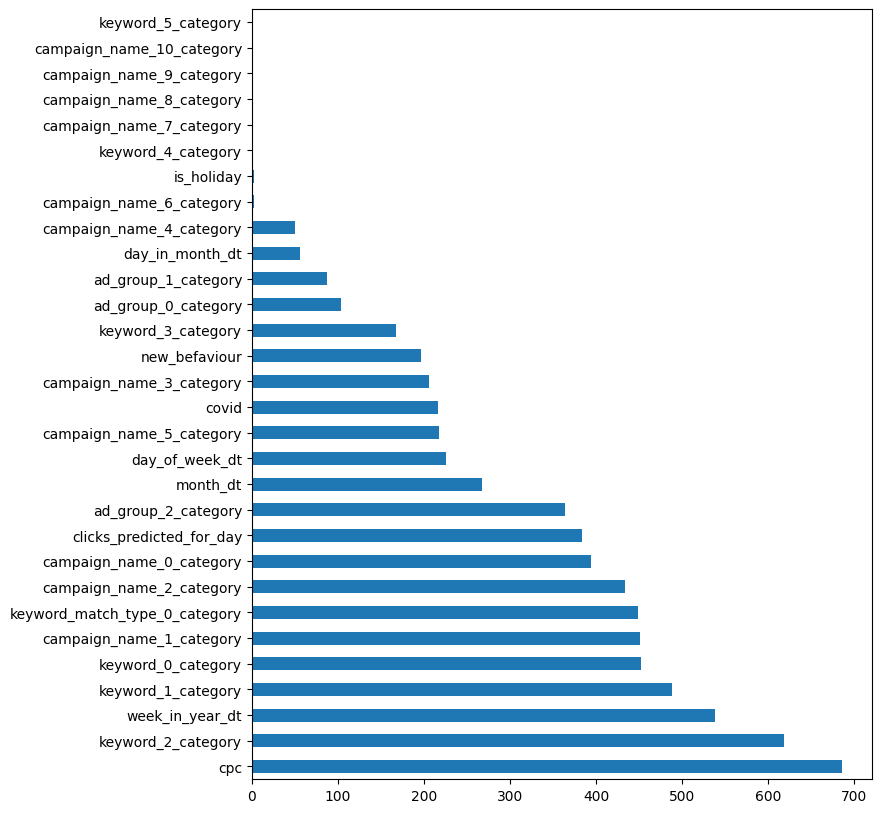

In [24]:
feat_imp = pd.Series(model.feature_importances_, index=X.columns)
feat_imp.nlargest(30).plot(kind='barh', figsize=(8,10))

In [25]:
def show_staistics(model, X_dataset , y_data_set):
    y_pred = model.predict(X_dataset)
    mse = mean_squared_error(y_data_set, y_pred)
    
    print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
    print("The mean absolute error (MAE) on test set: {:.4f}".format(mean_absolute_error(y_data_set, y_pred)))
    print("The RMSE on test set: {:.4f}".format(sqrt(mse)))
    print("The r2_score on test set: {:.4f}".format(r2_score(y_data_set, y_pred)))
    print("The smape on test set: {:.4f}".format(smape(y_data_set, y_pred)))
    print("The vape on test set: {:.4f}".format(vape(y_data_set, y_pred)))

In [26]:
show_staistics(model, X_test , y_test)

The mean squared error (MSE) on test set: 0.8611
The mean absolute error (MAE) on test set: 0.1907
The RMSE on test set: 0.9280
The r2_score on test set: 0.5766
The smape on test set: 173.4624
The vape on test set: 0.5837


In [22]:
show_staistics(model, X_test , y_test)

The mean squared error (MSE) on test set: 0.6873
The mean absolute error (MAE) on test set: 0.1816
The RMSE on test set: 0.8290
The r2_score on test set: 0.6473
The smape on test set: 172.9907
The vape on test set: 0.5513


In [27]:
show_staistics(model, val_x , val_y)

The mean squared error (MSE) on test set: 0.4260
The mean absolute error (MAE) on test set: 0.1986
The RMSE on test set: 0.6527
The r2_score on test set: 0.4795
The smape on test set: 172.7344
The vape on test set: 0.6839


In [24]:
show_staistics(model, val_x , val_y)

The mean squared error (MSE) on test set: 0.3367
The mean absolute error (MAE) on test set: 0.1776
The RMSE on test set: 0.5803
The r2_score on test set: 0.5885
The smape on test set: 172.4793
The vape on test set: 0.6116


In [25]:
show_staistics(model, X_train , y_train)

The mean squared error (MSE) on test set: 0.7111
The mean absolute error (MAE) on test set: 0.1798
The RMSE on test set: 0.8432
The r2_score on test set: 0.6389
The smape on test set: 173.1877
The vape on test set: 0.5498


In [26]:
show_staistics(model, X_train , y_train)

The mean squared error (MSE) on test set: 0.7111
The mean absolute error (MAE) on test set: 0.1798
The RMSE on test set: 0.8432
The r2_score on test set: 0.6389
The smape on test set: 173.1877
The vape on test set: 0.5498


In [28]:
df['pred'] = model.predict(df.drop(['clicks',"pred","date_obj","date"], axis=1, errors="ignore"))
df['date_obj'] = pd.to_datetime(df['date']).dt.date
df_gp = df.groupby(['date_obj'], as_index=False).agg({
    "clicks": sum,
    "pred":sum
})

In [29]:
val_df['pred'] = model.predict(val_df.drop(['clicks',"pred","date_obj","date"], axis=1, errors="ignore"))
val_df['date_obj'] = pd.to_datetime(val_df['date']).dt.date
val_gp = val_df.groupby(['date_obj'], as_index=False).agg({
    "clicks": sum,
    "pred":sum
})

In [30]:
val_df_0 = val_df.copy()
val_df_0["cpc"] = 0
val_df_0['pred'] = model.predict(val_df_0.drop(['clicks',"pred","date_obj","date"], axis=1, errors="ignore"))
val_df_0['date_obj'] = pd.to_datetime(val_df_0['date']).dt.date
val_gp_0 = val_df_0.groupby(['date_obj'], as_index=False).agg({
    "clicks": sum,
    "pred":sum
})

In [31]:

fig = px.line(val_gp, x="date_obj", y=["clicks","pred"], title='Validation Real CPC')
fig.show()

In [32]:

fig = px.line(val_gp_0, x="date_obj", y=["clicks","pred"], title='Validation ZERO CPC')
fig.show()

In [33]:

fig = px.line(df_gp, x="date_obj", y=["clicks","pred"], title='Traind data')
fig.show()


In [34]:
y_pred = model.predict(X_test)
fig = px.line(y_pred, x=range(len(y_pred)), y=[y_test,y_pred], title='Life expectancy in Canada')
fig.show()

In [35]:
%%time
report_for_number_rows = 20000
X_train_sample = X_train.sample(report_for_number_rows)
shap_values = shap.TreeExplainer(model.booster_).shap_values(X_train_sample)


CPU times: user 32.7 s, sys: 249 ms, total: 32.9 s
Wall time: 11.1 s


/Users/vyacheslav/.pyenv/versions/3.9.12/envs/adhome_ml/lib/python3.9/site-packages/shap/plots/_beeswarm.py:664: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



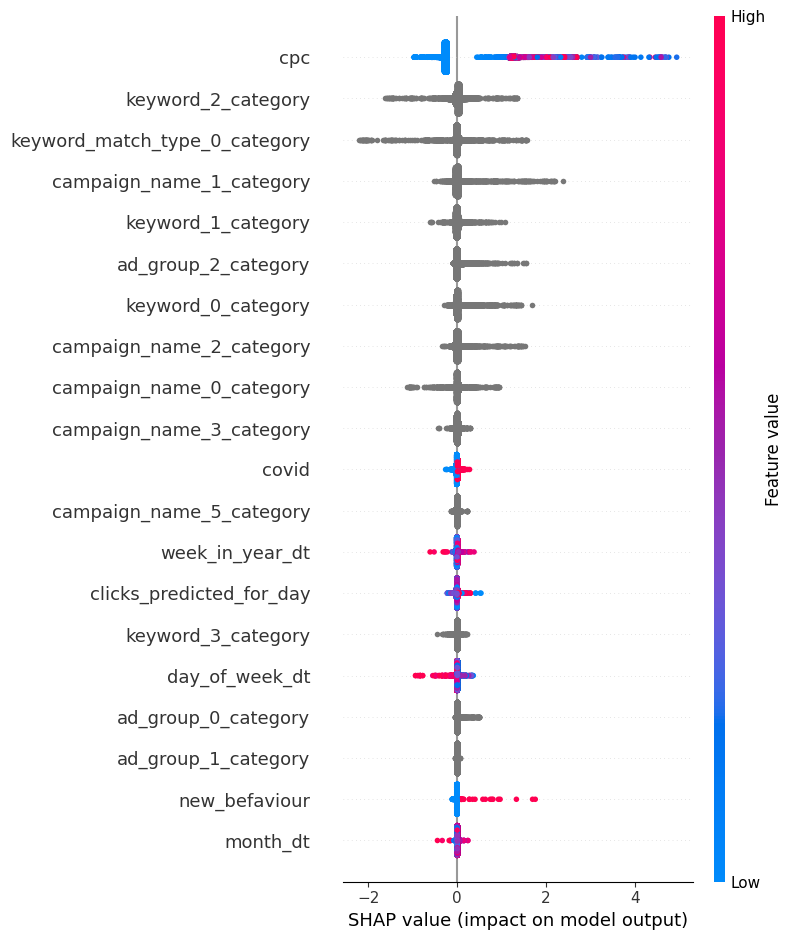

In [36]:
shap.summary_plot(shap_values,X_train_sample)


In [ ]:
from sklearn.model_selection import GridSearchCV
from joblib import parallel_backend

In [ ]:

params = {
    'num_leaves': [60,70,80],
    'learning_rate': [0.1,],
    'max_depth': [-1,],
      "min_split_gain": [0.36004551515184435],
  "min_child_weight": [6.680517668416932],
  "min_child_samples": [3,5,10],
    'n_estimators': [600,700,800],
}


grid = GridSearchCV(lgb.LGBMRegressor(random_state=0), 
                    params, 
                    scoring='r2', 
                    n_jobs=-1,
                    cv=5, 
                    verbose=10)

In [ ]:
%%time
with parallel_backend('multiprocessing'):
    grid.fit(X_train, y_train)
var = grid.best_estimator_
grid.best_params_